# Suppl Figures showing feature extraction workflow

In [125]:
import squidpy as sq
import scanpy as sc
import skimage
import numpy as np
import os
import matplotlib.pyplot as plt
import seaborn as sns

In [46]:
# load data
img = sq.datasets.visium_hne_image_crop()
adata = sq.datasets.visium_hne_adata_crop()

## Image processing figures

In [47]:
# make hne image a bit brighter
p2, p98 = np.percentile(img["image"], (0.5, 99.5))
img_rescale = img.apply(skimage.exposure.rescale_intensity, in_range=(p2, p98), copy=True)
img.add_img(img_rescale["image"], layer="image_rescaled")

# smooth image
sq.im.process(img, layer="image", method="smooth", sigma=2)

# segment image
sq.im.segment(img=img, layer="image_smooth", method="watershed", thresh=None, geq=False)

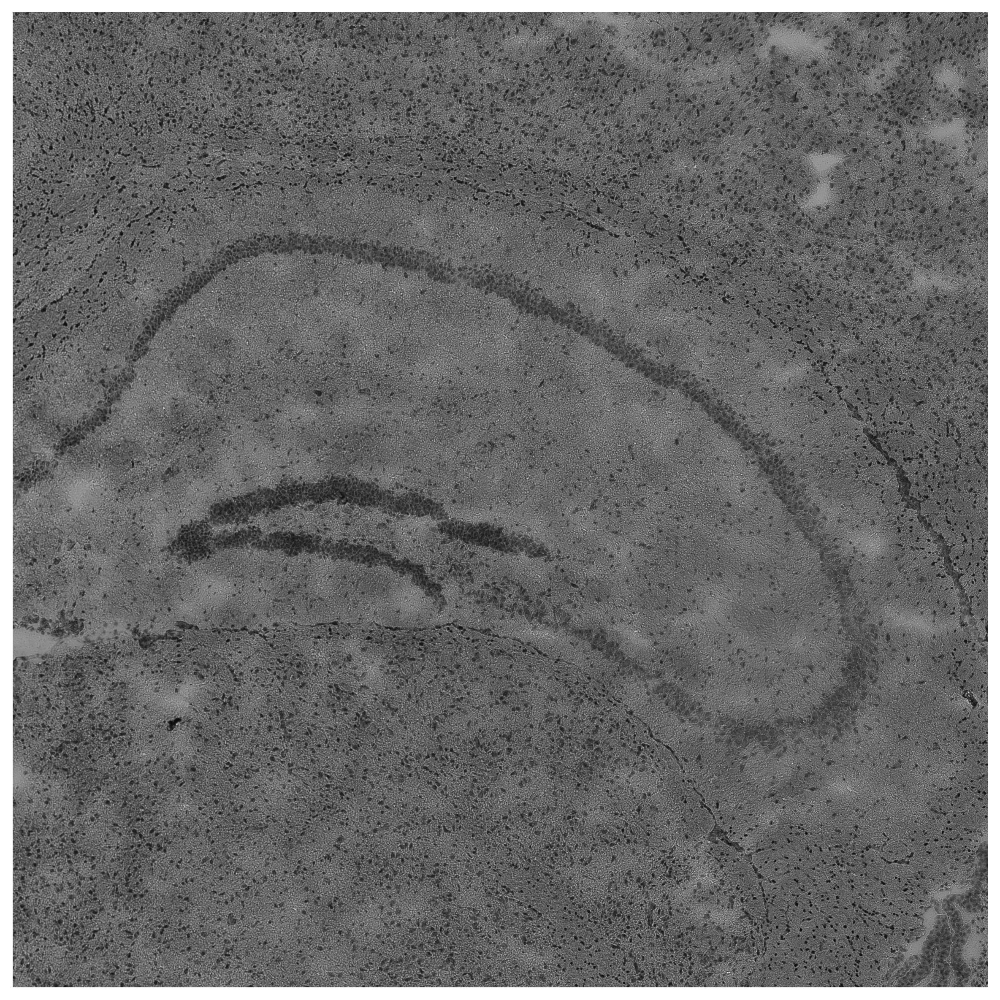

In [133]:
# smooth image
sq.im.process(img, layer="image", method="gray")
img.show("image_gray", dpi=300, save="hne_gray.png", cmap='gray')

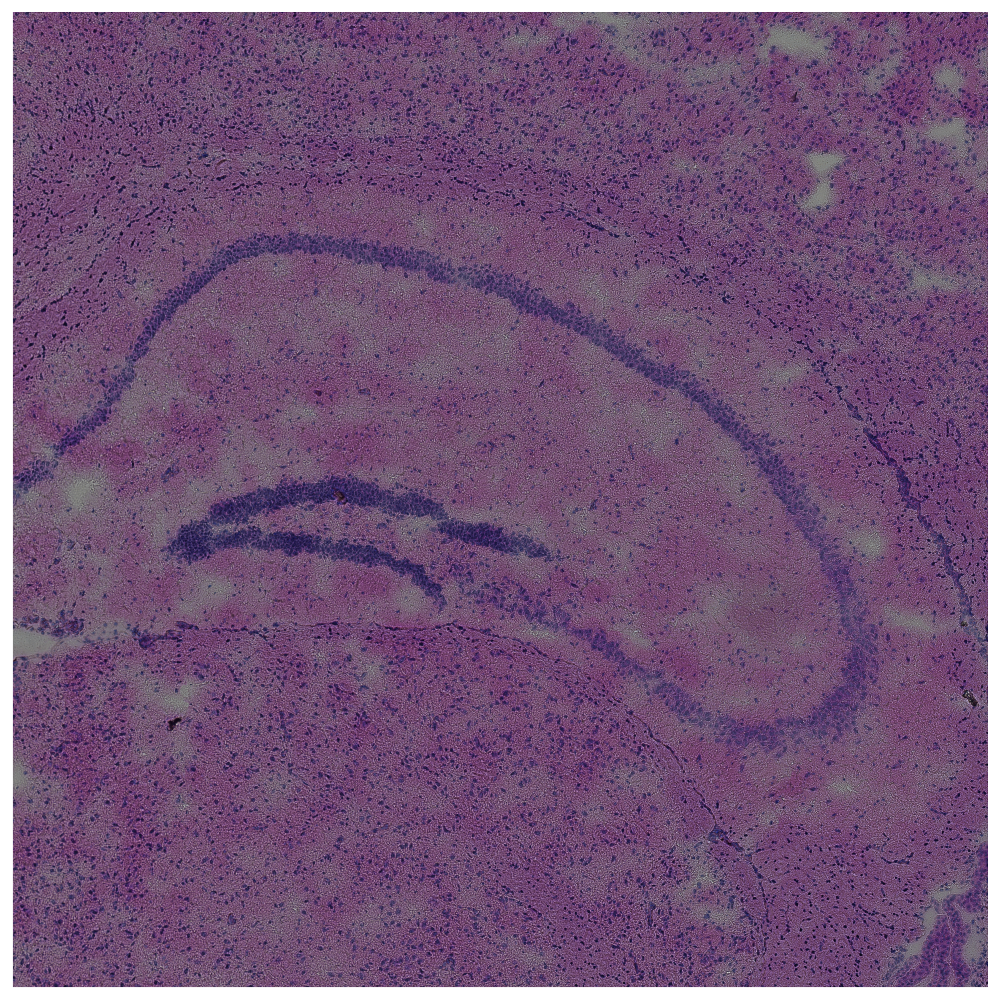

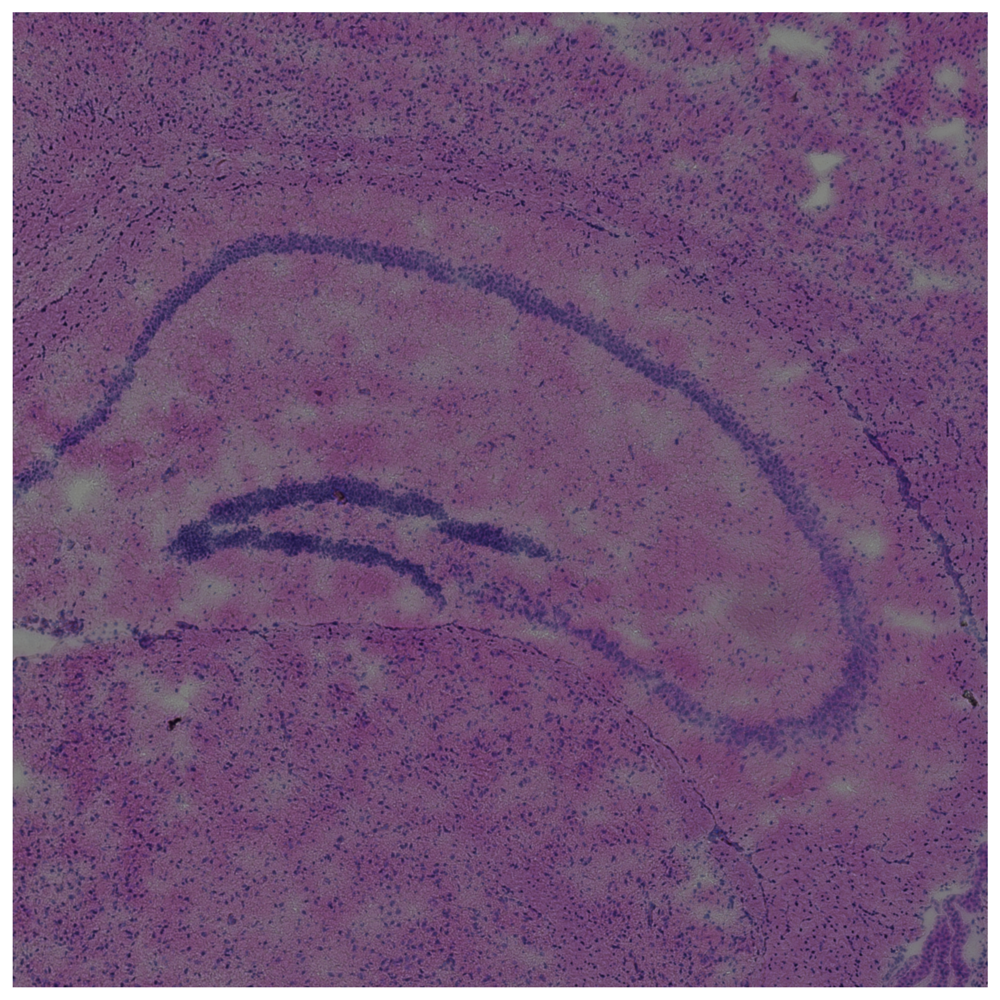

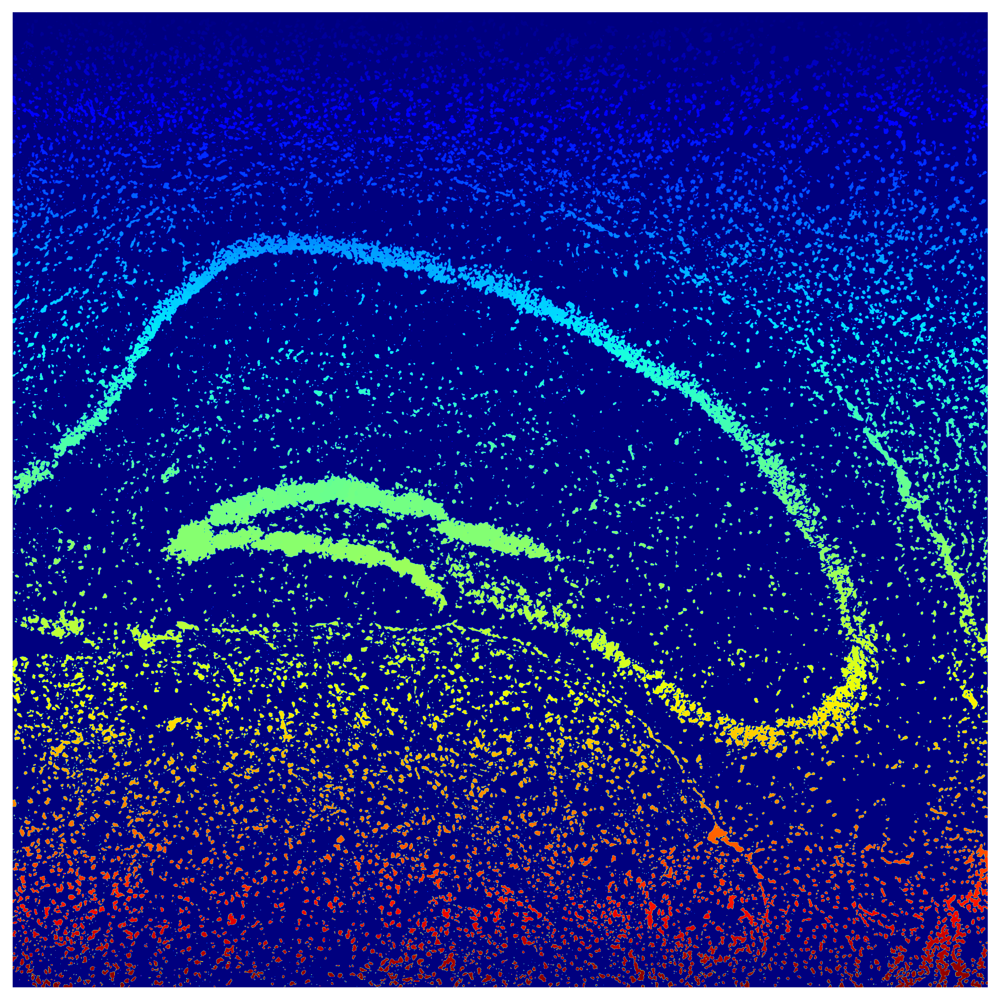

In [66]:
# save images
img.show("image", dpi=300, save="hne_image.png")
# save images
#img.show("image_smooth", dpi=300, save="hne_smooth.png")
# save images
img.show("segmented_watershed", dpi=300, save="hne_segmented.png", cmap="jet")

## Image features matrix figure

In [68]:
# calculate features
sq.im.calculate_image_features(adata, 
                               img, 
                               layer="image", 
                               key_added='features', 
                               features=['summary', 'segmentation'],
                               n_jobs=4, 
                               spot_scale=1, 
                               scale=1.0, 
                               mask_circle=True, 
                               features_kwargs={'segmentation':{'label_layer':"segmented_watershed"}})

In [69]:
adata.obsm['features']

,segmentation_label,segmentation_area_mean,segmentation_area_std,segmentation_ch-0_mean_intensity_mean,segmentation_ch-0_mean_intensity_std,segmentation_ch-1_mean_intensity_mean,segmentation_ch-1_mean_intensity_std,segmentation_ch-2_mean_intensity_mean,segmentation_ch-2_mean_intensity_std,summary_ch-0_quantile-0.9,...,summary_ch-1_quantile-0.9,summary_ch-1_mean,summary_ch-1_std,summary_ch-1_quantile-0.5,summary_ch-1_quantile-0.1,summary_ch-2_quantile-0.9,summary_ch-2_mean,summary_ch-2_std,summary_ch-2_quantile-0.5,summary_ch-2_quantile-0.1
AAAGACCCAAGTCGCG-1,12,68.583333,70.157511,69.592660,5.340461,49.932819,8.428854,89.163126,14.178756,136.0,...,105.0,61.570256,39.142212,71.0,0.0,138.0,88.420906,51.716442,108.0,0.0
AAAGGGATGTAGCAAG-1,5,10.200000,11.303097,76.899702,7.902705,49.723909,9.063152,81.034226,14.558960,140.0,...,104.0,61.294029,38.426191,70.0,0.0,138.0,86.954930,51.650818,103.0,0.0
AAAGTCACTGATGTAA-1,9,46.111111,65.864245,72.054219,7.639157,58.058794,9.890541,87.988097,6.742635,135.0,...,119.0,74.117914,45.040009,89.0,0.0,138.0,90.580987,52.432608,112.0,0.0
AAATGGCATGTCTTGT-1,12,70.916667,71.113124,71.928928,4.690436,44.900979,5.332289,85.604611,7.747912,134.0,...,96.0,55.392753,35.656027,64.0,0.0,138.0,86.517359,51.266960,103.0,0.0
AAATGGTCAATGTGCC-1,8,48.500000,59.266348,68.283302,6.142698,45.632297,7.254727,85.557058,9.388080,142.0,...,108.0,61.870976,39.741225,69.0,0.0,141.0,88.322055,52.049933,106.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTGTAATCCGTACTCG-1,21,59.380952,70.813286,74.156947,7.032748,51.808536,6.448948,90.983932,9.795077,139.0,...,106.0,59.056180,39.028694,66.0,0.0,142.0,87.344653,52.241279,103.0,0.0
TTGTATCACACAGAAT-1,13,46.153846,50.436321,76.271332,6.947036,54.090469,4.853202,96.537465,7.167203,135.0,...,99.0,60.165383,37.000594,71.0,0.0,136.0,88.080924,51.115047,108.0,0.0
TTGTCGTTCAGTTACC-1,8,17.750000,21.498546,74.782018,4.502802,54.604305,8.869913,82.184299,16.340268,139.0,...,113.0,68.560535,42.391981,80.0,0.0,138.0,88.496149,51.824846,107.0,0.0
TTGTGGCCCTGACAGT-1,10,40.500000,33.407335,76.656463,7.165009,55.984514,5.428119,98.736078,8.945817,140.0,...,108.0,63.634895,39.949966,73.0,0.0,138.0,87.861760,51.500217,106.0,0.0


In [98]:
# create image crops for obs x features matrix figure
obs_names = adata.obs.index[:10]
crops = []
# make crops slightly larger to make images pretty
for crop in img.generate_spot_crops(adata, obs_names=obs_names, as_array="image", spot_scale=1.1):
    crops.append(crop)

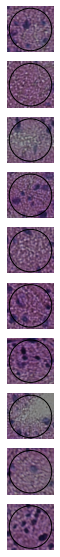

In [104]:
fig,axes = plt.subplots(10,1, figsize=(1,10))
for i,ax in enumerate(axes):
    ax.imshow(crops[i])
    # get position for spot circle
    d = adata.uns['spatial']['V1_Adult_Mouse_Brain']['scalefactors']['spot_diameter_fullres']
    c = crops[i].shape[0]/2
    circle = plt.Circle((c,c), radius=d/2, edgecolor="black", fill=False)
    ax.add_patch(circle)
    ax.axis("off")
plt.savefig('figures/obs_crops.png', dpi=300)

In [110]:
# plot selected features matrix
features_to_plot = ['segmentation_label', 'summary_ch-0_mean', 'summary_ch-1_mean', 'summary_ch-2_mean', 'segmentation_ch-0_mean_intensity_mean',
       'segmentation_ch-0_mean_intensity_std',
       'segmentation_ch-1_mean_intensity_mean',
       'segmentation_ch-1_mean_intensity_std',
       'segmentation_ch-2_mean_intensity_mean',
       'segmentation_ch-2_mean_intensity_std' ]

features = adata.obsm['features'][features_to_plot].iloc[:10]

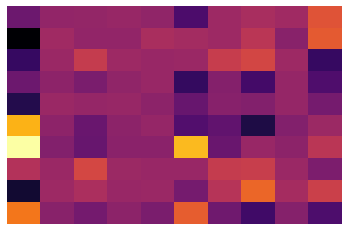

In [124]:
fig, ax = plt.subplots(1,1)
sns.heatmap(features / features.sum(axis=0), cmap='inferno', cbar=False, ax=ax)
ax.axis('off')
plt.savefig('figures/obs_features_matrix.png', dpi=300)